# Image Style Transfer Methods from Scratch: Gram Matrix (GM) vs. Sliced Wasserstein Distance (SWD)

This notebook implements two popular methods for image style transfer from scratch: the **Gram Matrix (GM)** method, and the **Sliced Wasserstein Distance (SWD)**. Feature activations from layers of the VGG19 network trained on ImageNet are used to extract representations of content and style from images.

A common challenge with style transfer lies in defining what "style" is, and how to create aesthetically pleasing images that balance between the original subject and newly applied design. GM and SWD differ in how they create representations of style from a given image.

Original works:

[1] A Neural Algorithm of Artistic Style: https://arxiv.org/pdf/1508.06576

[2] Sliced Wasserstein Distance for Neural Style Transfer: https://www.sciencedirect.com/science/article/pii/S0097849321002600


In [ ]:
import tensorflow as tf
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import os
import time
import PIL

In [6]:
print(tf.__version__)
print(tf.config.list_physical_devices('GPU'))

2.16.2
[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


## Load & Process Images

Pre-processing steps:

- Reduce image sizes to 512px (used in [1]) to reduce computational load
- Ensure content & style images are the same size to simplify matrix operations for SWD

I chose four different content-style image sets to experiment on:

1. A photo of a yellow lrabrador retriever, and Kandinsky's Composition 7, used in [1]. The yellow lab is a clear subject, and Composition 7 has distinct colours, shapes, patterns, and textures

2. A goose, and a shattering/reflecting glitch effect. The glitch image has specks of bright colour and a warping effect that might give interesting results.

3. A brick wall, and a bunch of fruit. These are both busy images with no clear subject. It might be an interesting experiment to see how each method deals with this combination.

4. A city scape at sunset, and Van Gogh's The Starry Night. Starry Night is another popular choice for style transfer experiments!


2025-07-14 23:18:18.597682: I metal_plugin/src/device/metal_device.cc:1154] Metal device set to: Apple M2 Pro
2025-07-14 23:18:18.597938: I metal_plugin/src/device/metal_device.cc:296] systemMemory: 16.00 GB
2025-07-14 23:18:18.597954: I metal_plugin/src/device/metal_device.cc:313] maxCacheSize: 5.33 GB
2025-07-14 23:18:18.598013: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:305] Could not identify NUMA node of platform GPU ID 0, defaulting to 0. Your kernel may not have been built with NUMA support.
2025-07-14 23:18:18.598263: I tensorflow/core/common_runtime/pluggable_device/pluggable_device_factory.cc:271] Created TensorFlow device (/job:localhost/replica:0/task:0/device:GPU:0 with 0 MB memory) -> physical PluggableDevice (device: 0, name: METAL, pci bus id: <undefined>)


\Four content/style pairs:



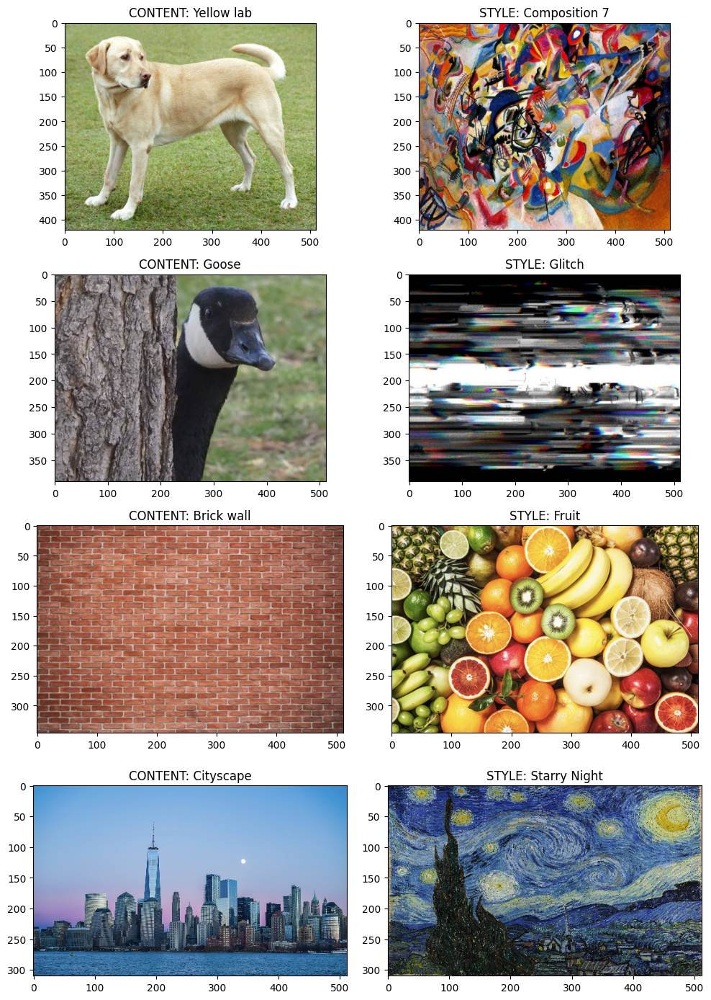

In [7]:
# for resizing to 512px max length
def process_image_keep_ratio(path, max_length=512):
    img = tf.io.read_file(path)
    img = tf.image.decode_image(img, channels=3, expand_animations=False)
    img = tf.image.convert_image_dtype(img, tf.float32)

    shape = tf.cast(tf.shape(img)[:-1], tf.float32)
    length = max(shape)
    scale = max_length / length

    new_shape = tf.cast(shape * scale, tf.int32)

    img = tf.image.resize(img, new_shape)
    img = img[tf.newaxis, :] # add batch dimension

    return img, new_shape

# for resizing to specific target dimensions
def process_image_fixed(path, target_dims):
    img = tf.io.read_file(path)
    img = tf.image.decode_image(img, channels=3, expand_animations=False)
    img = tf.image.convert_image_dtype(img, tf.float32)

    img = tf.image.resize(img, target_dims)
    img = img[tf.newaxis, :]

    return img


# resize content image to 512, and resize corresponding style image to match content image dimensions

# Set 1: yellow lab and composition 7
yellowlab, yellowlab_dims = process_image_keep_ratio('content/yellowlab.jpeg')
composition7 = process_image_fixed('styles/composition7.jpeg', target_dims=yellowlab_dims.numpy())

# Set 2: goose and glitch
goose, goose_dims = process_image_keep_ratio('content/goose.png')
glitch = process_image_fixed('styles/glitch.png', target_dims=goose_dims.numpy())

# Set 3: brick wall and fruit
brickwall, brickwall_dims = process_image_keep_ratio('content/brickwall.png')
fruit = process_image_fixed('styles/fruit.png', target_dims=brickwall_dims.numpy())

# Set 4: city scape and starry night
cityscape, cityscape_dims = process_image_keep_ratio('content/cityscape.png')
starrynight = process_image_fixed('styles/starrynight.jpg', target_dims=cityscape_dims.numpy())

print("\Four content/style pairs:\n")

plt.figure(figsize=(10, 14))

plt.subplot(4, 2, 1)
plt.imshow(yellowlab[0])
plt.title('CONTENT: Yellow lab')

plt.subplot(4, 2, 2)
plt.imshow(composition7[0])
plt.title('STYLE: Composition 7')

plt.subplot(4, 2, 3)
plt.imshow(goose[0])
plt.title('CONTENT: Goose')

plt.subplot(4, 2, 4)
plt.imshow(glitch[0])
plt.title('STYLE: Glitch')

plt.subplot(4, 2, 5)
plt.imshow(brickwall[0])
plt.title('CONTENT: Brick wall')

plt.subplot(4, 2, 6)
plt.imshow(fruit[0])
plt.title('STYLE: Fruit')

plt.subplot(4, 2, 7)
plt.imshow(cityscape[0])
plt.title('CONTENT: Cityscape')

plt.subplot(4, 2, 8)
plt.imshow(starrynight[0])
plt.title('STYLE: Starry Night')

plt.tight_layout()
plt.show()

## Content & Style Feature Extraction


### Load VGG19

VGG19 is a well-known convolutional neural network for image classification tasks. The model loaded below is pre-trained on ImageNet.

Each convolutional layer transforms the input into a set of feature maps that reflect specific visual patterns. Stacking these layers allows the model to build increasingly abstract representations of the image.


In [8]:
vgg = tf.keras.applications.VGG19(include_top=False, weights='imagenet')
vgg.trainable = False

for layer in vgg.layers:
   print(layer.name)

input_layer
block1_conv1
block1_conv2
block1_pool
block2_conv1
block2_conv2
block2_pool
block3_conv1
block3_conv2
block3_conv3
block3_conv4
block3_pool
block4_conv1
block4_conv2
block4_conv3
block4_conv4
block4_pool
block5_conv1
block5_conv2
block5_conv3
block5_conv4
block5_pool


In the context of image style transfer, VGG19 can be repurposed to extract **content** and **style** features from images:

- **Content**: `block5_conv_2` - Captures high-level subjects, shapes and colours
- **Style**: `block1_conv1`, `block2_conv1`, `block3_conv1`, `block4_conv1`, `block5_conv1` - Span low to high-level features to capture finer textures and overall patterns

In each of the style transfer methods, a specific loss function is implemented to balance between the appearance of the main subjects extracted from the **content** image, and the style elements extracted from the **style** image.


### Feature Extraction

To extract content & style features using these layers, pass an image through VGG19, and have the model output its representation of the image at the chosen layers.


In [9]:
content_layers = ['block5_conv2']
style_layers = ['block1_conv1', 'block2_conv1', 'block3_conv1', 'block4_conv1', 'block5_conv1']

# VGG model that outputs the image representation at desired layers
def vgg_style_transfer(vgg, layers):
  outputs = [vgg.get_layer(name).output for name in layers]

  model = tf.keras.Model([vgg.input], outputs)
  return model

def get_features(model, content_img, style_img):
    content_outputs = model(content_img)
    style_outputs = model(style_img)

    # keep batch dimension
    content_features = [layer_output for layer_output in content_outputs[len(style_layers):]]
    style_features = [layer_output for layer_output in style_outputs[:len(style_layers)]]

    return content_features, style_features

In [10]:
model = vgg_style_transfer(vgg, content_layers + style_layers)

yellowlab_features, composition7_features = get_features(model, yellowlab, composition7)
goose_features, glitch_features = get_features(model, goose, glitch)
brickwall_features, fruit_features = get_features(model, brickwall, fruit)
cityscape_features, starrynight_features = get_features(model, cityscape, starrynight)

print("\nExample: shapes of Yellow Lab & Composition 7 features:\n")
for name, feature in zip(content_layers, yellowlab_features):
    print(f"{name}: Content feature shape: {feature.shape}")
for name, feature in zip(style_layers, composition7_features):
    print(f"{name}: Style feature shape: {feature.shape}")


Example: shapes of Yellow Lab & Composition 7 features:

block5_conv2: Content feature shape: (1, 26, 32, 512)
block1_conv1: Style feature shape: (1, 26, 32, 512)
block2_conv1: Style feature shape: (1, 422, 512, 64)
block3_conv1: Style feature shape: (1, 211, 256, 128)
block4_conv1: Style feature shape: (1, 105, 128, 256)
block5_conv1: Style feature shape: (1, 52, 64, 512)


## Gram Matrix (GM) Method

The **Gram Matrix** [1] captures **correlations** between feature maps, representing how different visual patterns (like colours and textures) tend to occur together. Strong correlations reflect consistent style elements that appear across the image, regardless of specific subjects.

The Gram Matrix will therefore combine the multiple extracted style features into a single **style representation**, which will then be applied to the content image.


In [11]:
def gram_matrix(features):
  # Gram Matrix
  result = tf.linalg.einsum('bijc,bijd->bcd', features, features)

  features_shape = tf.shape(features)
  num_entries = tf.cast(features_shape[1]*features_shape[2], tf.float32)

  return result / num_entries

### Loss functions

The Gram Matrix method uses simple mean-squared-error loss functions to measure how much content, versus how much style (defined by the above matrix representation of style) is present in a combined image, and control the balance between the two.


In [12]:
def content_loss_MSE(content, target_content):
    content_loss = tf.reduce_mean(tf.square(content - target_content))
    return content_loss

def style_loss_MSE(style, target_style):
    style_loss = tf.reduce_mean(tf.square(style - target_style))
    return style_loss

### Optimization Loop

Style transfer happens over many iterations. We start with the content image and then gradually update it based on content/style loss. Each training step (iteration) follows this process:

1. **Extract content & style features** from the current generated image:

   - Target content/style features come from the original content and style images
   - Current features come from the image being optimized (current state of style transfer)

2. **Calculate losses**:

   - **Content loss** compares the current image’s content features to the target content features.
   - **Style loss** compares the Gram Matrices of the current and target style features.
   - **Variation loss** encourages smoothness by penalizing noise in the generated image

3. **Combine losses** with three parameters:

   ```math
   \text{Total Loss} = \alpha \times \text{Content Loss} + \beta \times \text{Style Loss} + \gamma \times \text{Variation Loss}

   ```

4. **Update the image** using gradient descent:
   - Compute gradients of the total loss with respect to the image.
   - Adjust the image in the direction that reduces total loss


In [13]:
class GM_Trainer:
    def __init__(self, model, content_loss, style_loss, alpha, beta, gamma, learning_rate=0.02):
        self.model = model
        self.content_loss = content_loss
        self.style_loss = style_loss
        self.alpha = alpha
        self.beta = beta
        self.gamma = gamma
        self.optimizer = tf.optimizers.Adam(learning_rate=learning_rate, beta_1=0.99, epsilon=1e-1)
        self._train_step_fn = self._make_train_step()
    
    # using tf.function to speed up runtime
    def _make_train_step(self):
        @tf.function
        def train_step(generated_image, target_content_features, target_style_features):
            with tf.GradientTape() as tape:
                gen_content_features, gen_style_features = get_features(self.model, generated_image, generated_image)

                current_content_loss = 0
                current_style_loss = 0

                for gen_feature, target_feature in zip(gen_content_features, target_content_features):
                    current_content_loss += self.content_loss(gen_feature, target_feature)

                for gen_feature, target_feature in zip(gen_style_features, target_style_features):
                    current_style_loss += self.style_loss(gram_matrix(gen_feature), gram_matrix(target_feature))

                tv_loss = tf.image.total_variation(generated_image)

                total_loss = (
                    self.alpha * current_content_loss +
                    self.beta * current_style_loss +
                    self.gamma * tv_loss
                )

            gradients = tape.gradient(total_loss, generated_image)
            self.optimizer.apply_gradients([(gradients, generated_image)])
            generated_image.assign(tf.clip_by_value(generated_image, 0.0, 1.0))

        return train_step

    def train_step(self, generated_image, content_features, style_features):
        self._train_step_fn(generated_image, content_features, style_features)


The optimization loop to implement the training step over a defined number of iterations is shown below (in this case, 10 epochs, 100 steps per epoch). This loop uses the Adam optimizer to adjust the learning rate for gradient descent over time.


In [14]:
def tensor_to_image(tensor):
    tensor = tensor * 255
    tensor = np.array(tensor, dtype=np.uint8)
    if np.ndim(tensor) > 3:
        assert tensor.shape[0] == 1
        tensor = tensor[0]
    return PIL.Image.fromarray(tensor)


def optimization_loop_GM(description, blended_image, content_features, style_features,
                         trainer, show_progression=True, epochs=10, steps_per_epoch=100, save_every=100):
    
    image_dir = os.path.join(f'results/GM/{description}/alpha {trainer.alpha} beta {trainer.beta} gamma {trainer.gamma}/')
    os.makedirs(image_dir, exist_ok=True)

    print(f"\nOutput for alpha={trainer.alpha}, beta={trainer.beta}, gamma={trainer.gamma}:\n")

    for n in range(epochs):
        for m in range(steps_per_epoch):
            trainer.train_step(blended_image, content_features, style_features)

            # option to show style transfer progress over time
            if show_progression and (m % save_every == 0):
                img = tensor_to_image(blended_image)

                plt.figure(figsize=(5, 5))
                plt.imshow(img)
                plt.title(f"After epoch {n}, step {m}")
                plt.axis('off')
                plt.show()

    # save & plot result at the end
    image_path = os.path.join(image_dir, f"epoch_{epochs}_step_{steps_per_epoch}.png")
    img = tensor_to_image(blended_image)
    img.save(image_path)

    plt.figure(figsize=(5, 5))
    plt.imshow(img)
    plt.title(f"After epoch {epochs}, step {steps_per_epoch}")
    plt.axis('off')
    plt.show()

### Experiment with alpha, beta, gamma values

A higher alpha will prioritize preserving content, whereas a higher beta will focus on preserving style. Gamma controls variation loss, and should be small enough that it doesn't smooth out important details or colours.

Added this cell to play with different values:



Output for alpha=10000, beta=1, gamma=0.01:



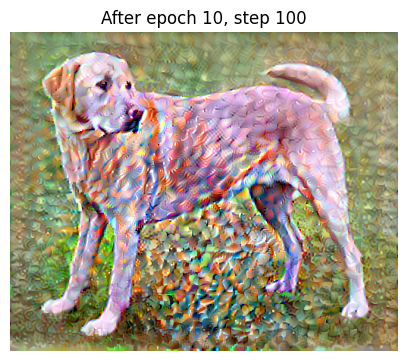

Runtime: 171.37 sec


Output for alpha=1000, beta=10, gamma=0.1:



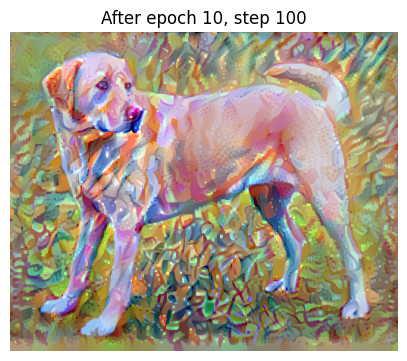

Runtime: 177.09 sec


Output for alpha=1000, beta=100, gamma=1.0:



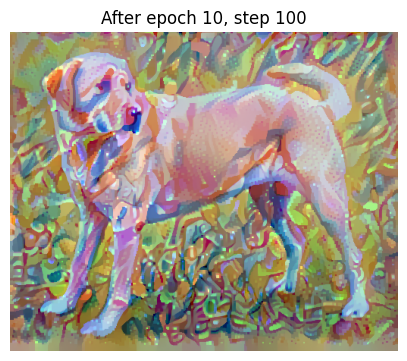

Runtime: 171.67 sec



In [ ]:
# blended image starts off as just content image
starting_image = tf.Variable(yellowlab, dtype=tf.float32)
trainer = GM_Trainer(model, content_loss_MSE, style_loss_MSE, alpha=10000, beta=1, gamma=0.01)

start = time.time()
optimization_loop_GM(
        'lab and composition', 
        starting_image, 
        yellowlab_features, 
        composition7_features, 
        trainer,
        show_progression=False,
    )
end = time.time()
print(f"Runtime: {end - start:.2f} sec\n")

starting_image = tf.Variable(yellowlab, dtype=tf.float32)
trainer = GM_Trainer(model, content_loss_MSE, style_loss_MSE, alpha=1000, beta=10, gamma=0.1)

start = time.time()
optimization_loop_GM(
        'lab and composition', 
        starting_image, 
        yellowlab_features, 
        composition7_features, 
        trainer,
        show_progression=False,
    )
end = time.time()
print(f"Runtime: {end - start:.2f} sec\n")

starting_image = tf.Variable(yellowlab, dtype=tf.float32)
trainer = GM_Trainer(model, content_loss_MSE, style_loss_MSE, alpha=1000, beta=100, gamma=1.0)

start = time.time()
optimization_loop_GM(
        'lab and composition', 
        starting_image, 
        yellowlab_features, 
        composition7_features, 
        trainer,
        show_progression=False,
    )
end = time.time()
print(f"Runtime: {end - start:.2f} sec\n")

### Gram Matrix method on 4 examples

Running the Gram Matrix method on each content/style pair, displaying the current image after each epoch to see how it moves toward its final goal.

For some examples, the alpha & beta values are slightly adjusted based on what might be more aesthetically pleasing for those specific content/style pairs.


In [ ]:
alpha = 1000
beta = 10
gamma = 0.01


Output for alpha=1000, beta=10, gamma=0.01:



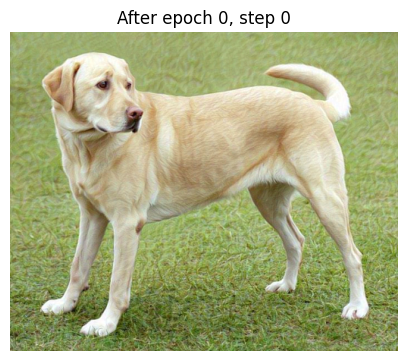

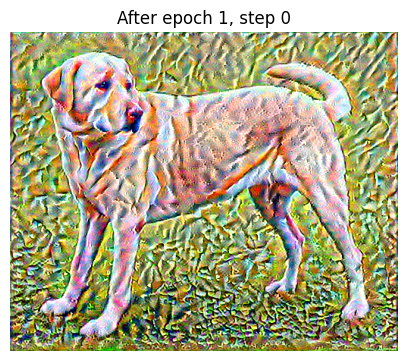

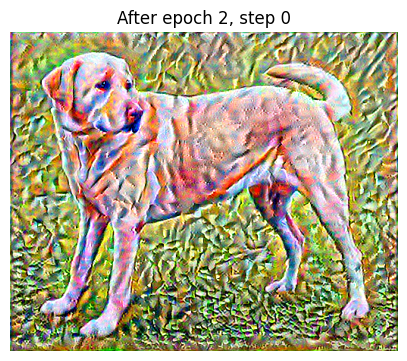

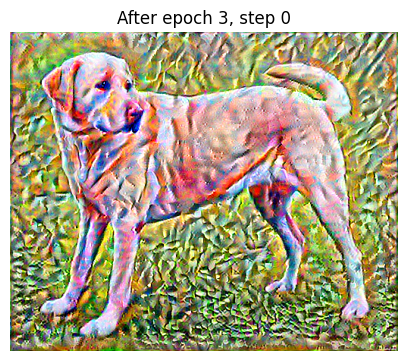

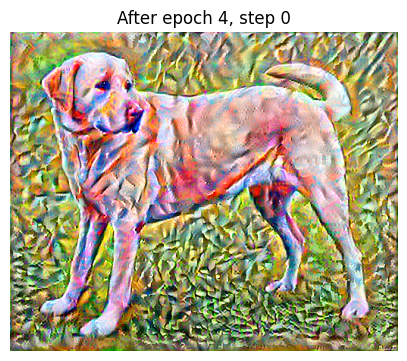

...

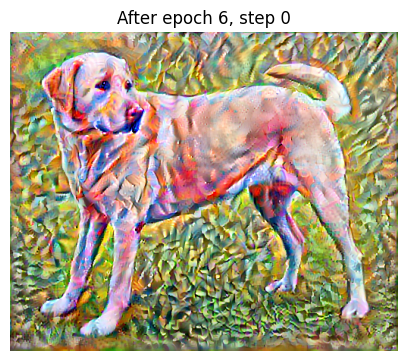

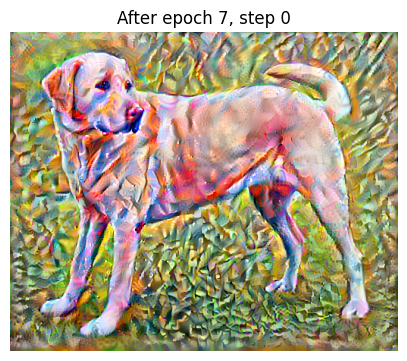

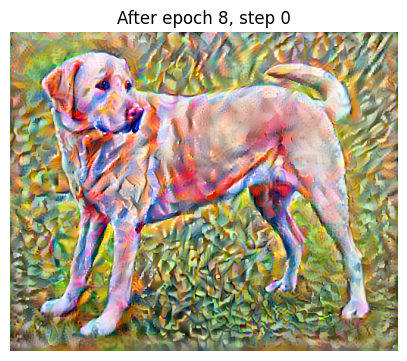

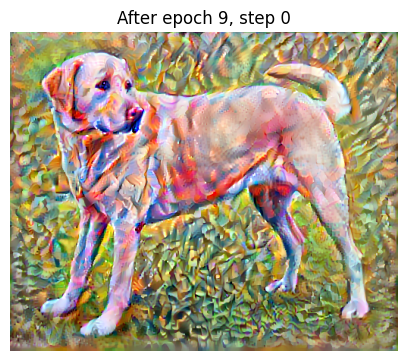

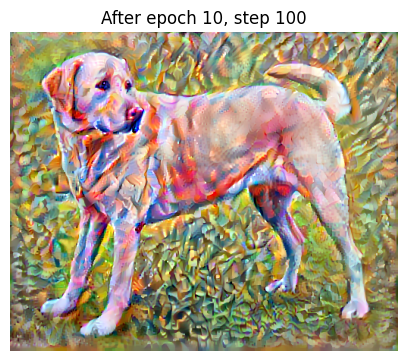

Runtime: 175.84 sec



In [ ]:
starting_image = tf.Variable(yellowlab, dtype=tf.float32)
trainer = GM_Trainer(model, content_loss_MSE, style_loss_MSE, alpha, beta, gamma)

start = time.time()
optimization_loop_GM(
        'lab and composition', 
        starting_image, 
        yellowlab_features, 
        composition7_features, 
        trainer,
        show_progression=True,
    )
end = time.time()
print(f"Runtime: {end - start:.2f} sec\n")


Output for alpha=1000, beta=10, gamma=0.01:



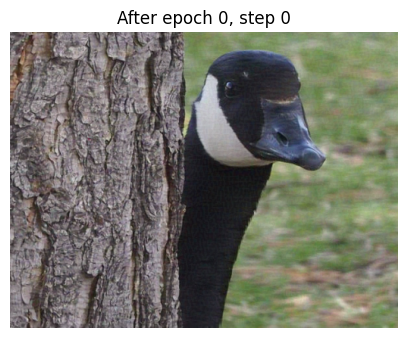

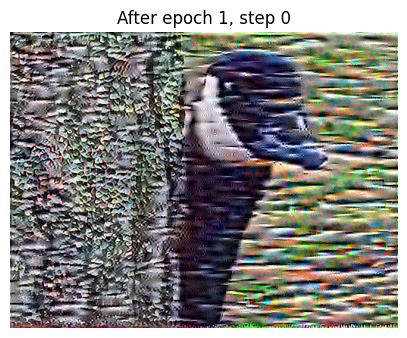

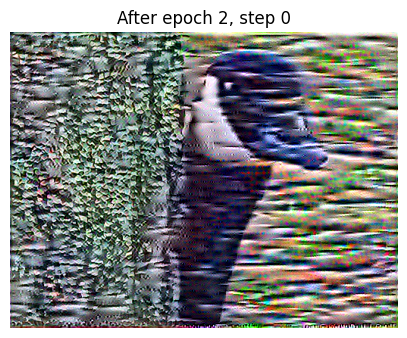

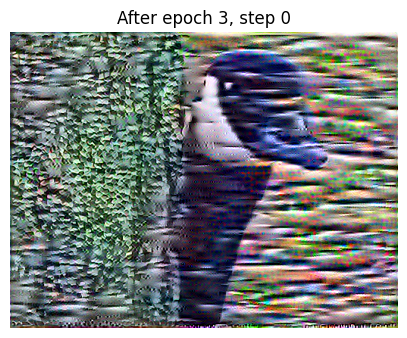

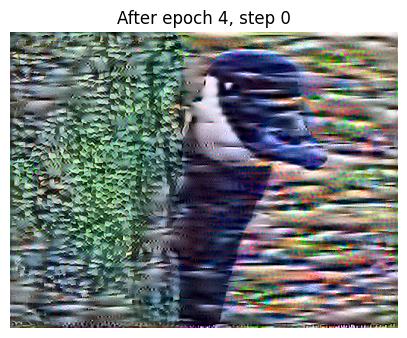

...

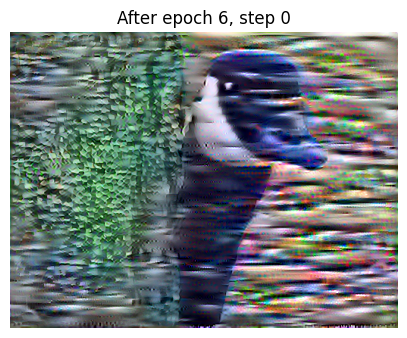

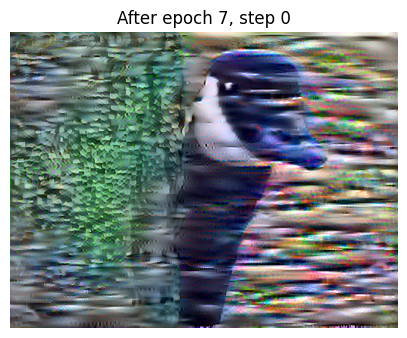

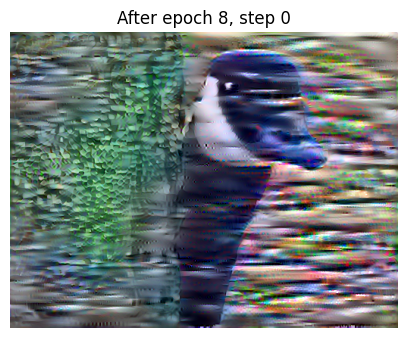

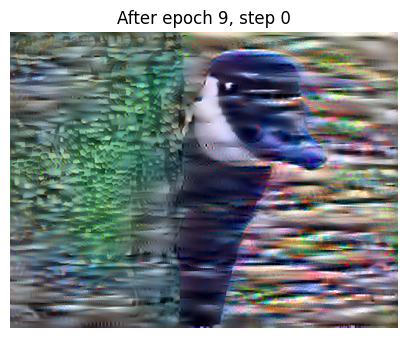

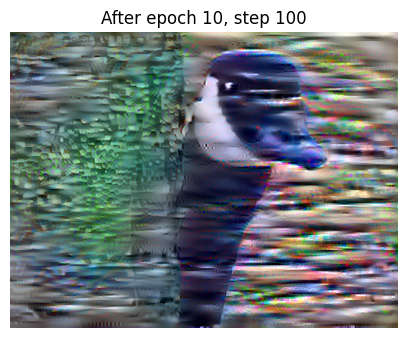

Runtime: 159.79 sec



In [ ]:
starting_image = tf.Variable(goose, dtype=tf.float32)
trainer = GM_Trainer(model, content_loss_MSE, style_loss_MSE, alpha, beta, gamma)

start = time.time()
optimization_loop_GM(
        'goose and glitch', 
        starting_image, 
        goose_features, 
        glitch_features, 
        trainer,
        show_progression=True,
    )
end = time.time()
print(f"Runtime: {end - start:.2f} sec\n")


Output for alpha=10000, beta=1.0, gamma=0.01:



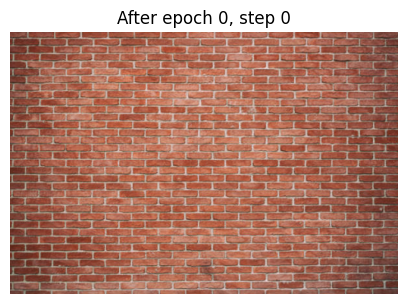

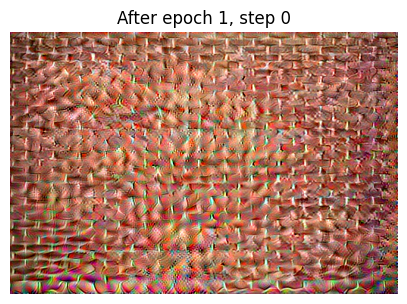

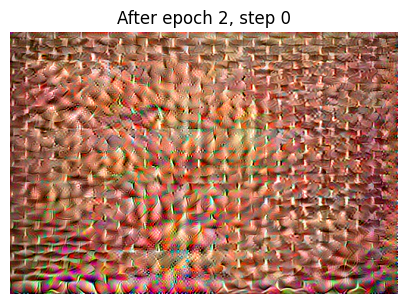

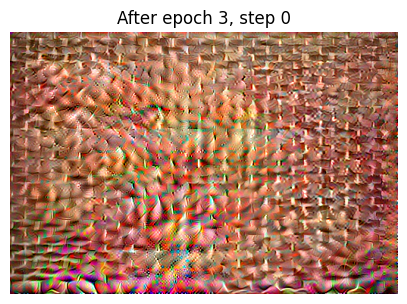

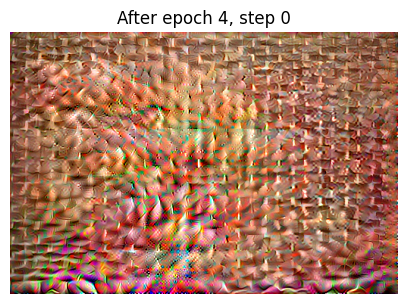

...

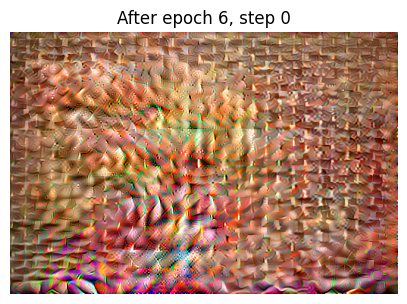

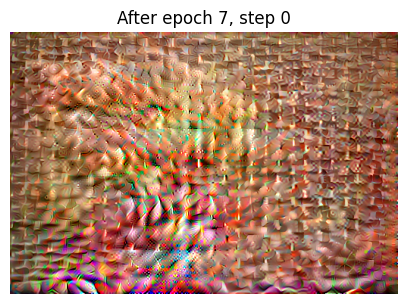

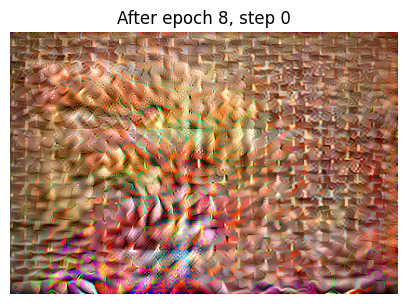

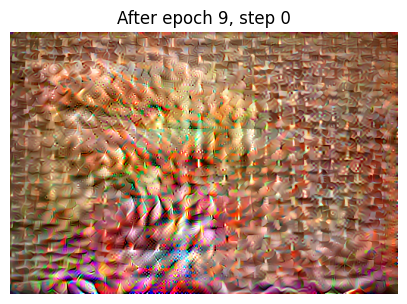

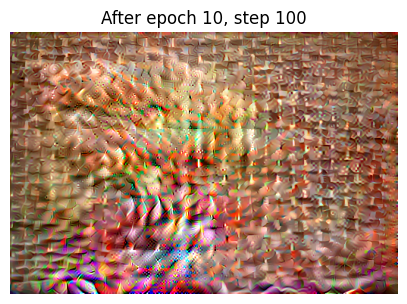

Runtime: 159.66 sec



In [239]:
starting_image = tf.Variable(brickwall, dtype=tf.float32)
trainer = GM_Trainer(model, content_loss_MSE, style_loss_MSE, alpha=10000, beta=1.0, gamma=0.01)

start = time.time()
optimization_loop_GM(
        'wall and fruit', 
        starting_image, 
        brickwall_features, 
        fruit_features, 
        trainer,
        show_progression=True,
    )
end = time.time()
print(f"Runtime: {end - start:.2f} sec\n")


Output for alpha=1000, beta=10, gamma=0.01:



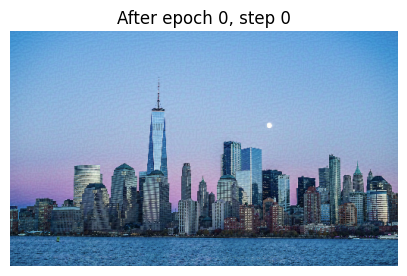

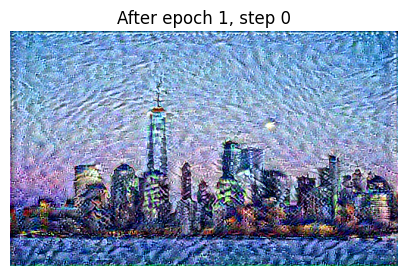

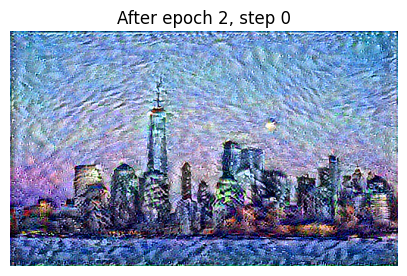

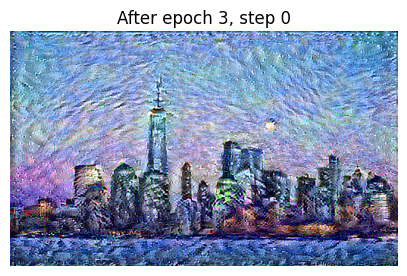

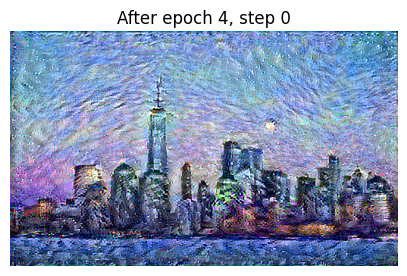

...

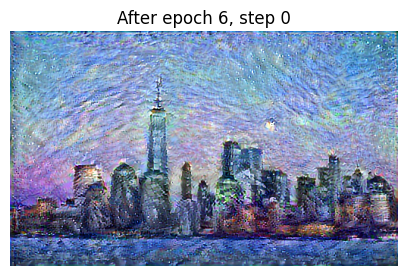

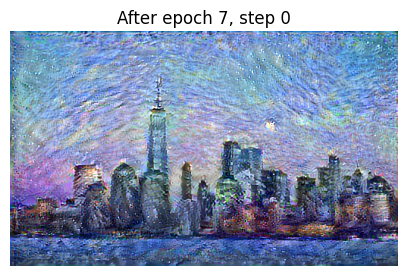

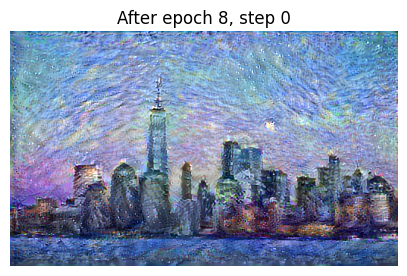

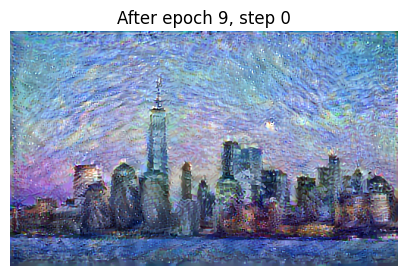

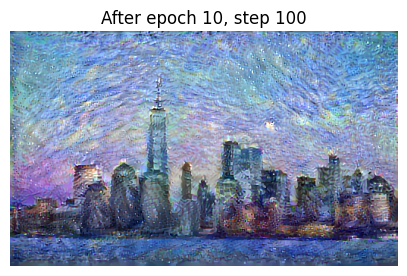

Runtime: 133.86 sec



In [238]:
starting_image = tf.Variable(cityscape, dtype=tf.float32)
trainer = GM_Trainer(model, content_loss_MSE, style_loss_MSE, alpha, beta, gamma)

start = time.time()
optimization_loop_GM(
        'cityscape and starry night', 
        starting_image, 
        cityscape_features, 
        starrynight_features, 
        trainer,
        show_progression=True,
    )
end = time.time()
print(f"Runtime: {end - start:.2f} sec\n")

## Sliced Wasserstein Distance (SWD) Method

**Sliced Wasserstein Distance** [2] is an effective method for image **texturing**.

Unlike the Gram Matrix, which defines an overall representation of style, SWD provides a more precise way to **compare** style features, by finding the distance between two style feature maps.

How SWD works:

- Flatten the feature maps into vectors, and normalize them so they all have the same relative scale.
- Within the space that the new feature vectors live in, create random vectors, pointing in **random directions**.
- **Project** the feature vectors onto the random vectors. So we now have a set of scalars representing the features, capturing how strongly each feature aligns with the selected direction.
- Sort the newly obtained scalars for both style feature maps in ascending order, and combine them into ordered pairs (i.e. each pair of scalars has one representing style 1, and one representing style 2, after both sets are sorted).
- Calculate the Euclidean distance between each ordered pair, and aggregate them to get the total SW distance between the two styles.

Projecting onto random directions helps us tap into a diverse variety of information from the feature maps.

Sorting the projections before calculating distance creates a **distribution** of the magnitude of the various style characteristics we've captured. The idea of SWD is that the essence of style is captured by this distrubution, so when we want to match an image's style, we're trying to get closer to its distribution of style features.


In [15]:
def normalize(features):
  normalized_features = []

  for feature in features:
    mean, variance = tf.nn.moments(feature, axes=[1, 2], keepdims=True)
    normalized = (feature - mean) / tf.sqrt(variance + 1e-5)
    normalized_features.append(normalized)

  return normalized_features

def flatten(features):
  flattened_features = []

  for feature in features:
    batch_size, height, width, channels = feature.shape
    flattened = tf.reshape(feature, (batch_size, height * width, channels))
    flattened_features.append(flattened)

  return flattened_features

# generate vectors in random directions, within same space as given feature dimension
def random_directions(n_directions, feature_dim):
  directions = tf.random.normal((n_directions, feature_dim))
  directions = directions / tf.norm(directions, axis=1, keepdims=True)
  return directions

# flatten & normalize our existing content/style features to prep for SWD
yellowlab_features_flattened = flatten(normalize(yellowlab_features))
composition7_features_flattened = flatten(normalize(composition7_features))
goose_features_flattened = flatten(normalize(goose_features))
glitch_features_flattened = flatten(normalize(glitch_features))
brickwall_features_flattened = flatten(normalize(brickwall_features))
fruit_features_flattened = flatten(normalize(fruit_features))
cityscape_features_flattened = flatten(normalize(cityscape_features))
starrynight_features_flattened = flatten(normalize(starrynight_features))

### Loss function

Implement projection, sorting, and distance calculations. `SWD_style_loss` applies this process across multiple feature maps, since multiple VGG19 are used for style.


In [16]:
def SWD(gen_features, style_features, n_directions=100):
    feature_dim = gen_features.shape[-1]
    directions = random_directions(n_directions, feature_dim)

    # project each set of features onto random vector set within feature space
    gen_projections = tf.matmul(gen_features, directions, transpose_b=True)
    style_projections = tf.matmul(style_features, directions, transpose_b=True)

    gen_projections = tf.sort(gen_projections, axis=-1)
    style_projections = tf.sort(style_projections, axis=-1)

    # SWD = Euclidean distance between sorted projections, summed over all directions
    swd = tf.norm(gen_projections - style_projections, ord='euclidean', axis=-1)
    return tf.reduce_sum(swd)


def SWD_style_loss(gen_features_list, style_features_list, n_directions=100):
    swd_losses = [SWD(gen_features, style_features, n_directions) for gen_features, style_features in zip(gen_features_list, style_features_list)]

    # total style loss is SWD over all layers
    style_loss = tf.reduce_sum(swd_losses)

    return style_loss

### Optimization loop

Same logic for the train step and optimization loop as with the Gram Matrix method, but define style loss via the SWD method, and make adjustments for normalizing & flattening features.

We still have alpha, beta, and gamma to control content, style and variation losses, respectively.


In [17]:
class SWD_Trainer:
    def __init__(self, model, content_loss, style_loss, alpha, beta, gamma, learning_rate=0.02):
        self.model = model
        self.content_loss = content_loss
        self.style_loss = style_loss
        self.alpha = alpha
        self.beta = beta
        self.gamma = gamma
        self.optimizer = tf.optimizers.Adam(learning_rate=learning_rate, beta_1=0.99, epsilon=1e-1)
        self._train_step_fn = self._make_train_step()

    def _make_train_step(self):
        @tf.function
        def train_step(generated_image, target_content_features, target_style_features):
            with tf.GradientTape() as tape:
                gen_content_features, gen_style_features = get_features(self.model, generated_image, generated_image)

                # normalize & flatten generated features
                gen_content_flat = flatten(normalize(gen_content_features))
                gen_style_flat = flatten(normalize(gen_style_features))

                current_content_loss = tf.add_n([
                    self.content_loss(g, t) for g, t in zip(gen_content_flat, target_content_features)
                ])
                current_style_loss = self.style_loss(gen_style_flat, target_style_features, n_directions=100)

                tv_loss = tf.image.total_variation(generated_image)
                total_loss = (
                    self.alpha * current_content_loss +
                    self.beta * current_style_loss +
                    self.gamma * tv_loss
                )

            gradients = tape.gradient(total_loss, generated_image)
            self.optimizer.apply_gradients([(gradients, generated_image)])
            generated_image.assign(tf.clip_by_value(generated_image, 0.0, 1.0))

        return train_step

    def train_step(self, generated_image, content_features, style_features):
        self._train_step_fn(generated_image, content_features, style_features)

In [18]:
def optimization_loop_SWD(description, blended_image, content_features, style_features,
                          trainer, show_progression=True, epochs=10, steps_per_epoch=100, save_every=100):

    image_dir = os.path.join(f'results/SWD/{description}/alpha {trainer.alpha} beta {trainer.beta} gamma {trainer.gamma}/')
    os.makedirs(image_dir, exist_ok=True)

    print(f"\nOutput for alpha={trainer.alpha}, beta={trainer.beta}, gamma={trainer.gamma}:\n")

    for n in range(epochs):
        for m in range(steps_per_epoch):
            trainer.train_step(blended_image, content_features, style_features)

            if show_progression and (m % save_every == 0):
                img = tensor_to_image(blended_image)

                plt.figure(figsize=(5, 5))
                plt.imshow(img)
                plt.title(f"After epoch {n}, step {m}")
                plt.axis('off')
                plt.show()

    image_path = os.path.join(image_dir, f"epoch_{epochs}_step_{steps_per_epoch}.png")
    img = tensor_to_image(blended_image)
    img.save(image_path)

    plt.figure(figsize=(5, 5))
    plt.imshow(img)
    plt.title(f"After epoch {epochs}, step {steps_per_epoch}")
    plt.axis('off')
    plt.show()

### Experiment with alpha, beta, gamma values

With the SWD method, the style tends to be significantly more dominant, so experiment with a much higher order of magnitude difference than before, favouring content preservation.



Output for alpha=10000, beta=0.01, gamma=0.01:



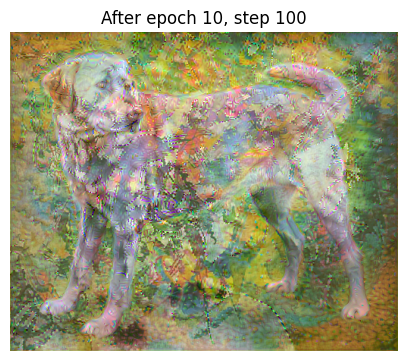

Runtime: 407.48 sec



In [207]:
starting_image = tf.Variable(yellowlab, dtype=tf.float32)
trainer = SWD_Trainer(model, content_loss_MSE, SWD_style_loss, alpha=10000, beta=0.01, gamma=0.01)

start = time.time()
optimization_loop_SWD(
    'lab and composition',
    starting_image,
    yellowlab_features_flattened,
    composition7_features_flattened,
    trainer,
    show_progression=False
)
end = time.time()
print(f"Runtime: {end - start:.2f} sec\n")


Output for alpha=10000, beta=0.001, gamma=0.001:



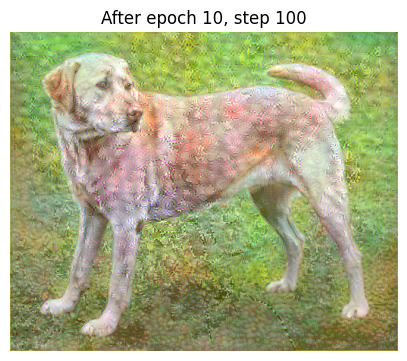

Runtime: 403.71 sec



In [208]:
starting_image = tf.Variable(yellowlab, dtype=tf.float32)
trainer = SWD_Trainer(model, content_loss_MSE, SWD_style_loss, alpha=10000, beta=0.001, gamma=0.001)

start = time.time()
optimization_loop_SWD(
    'lab and composition',
    starting_image,
    yellowlab_features_flattened,
    composition7_features_flattened,
    trainer,
    show_progression=False
)
end = time.time()
print(f"Runtime: {end - start:.2f} sec\n")

### SWD method on 4 examples

Run SWD style transfer on all 4 content/style pairs, showing the output at each epoch. As before, alpha/beta/gamma values are adjusted for some examples based on what might be more aesthetically pleasing for those images.


In [258]:
alpha = 10000
beta = 0.05
gamma = 0.1


Output for alpha=10000, beta=0.05, gamma=0.1:



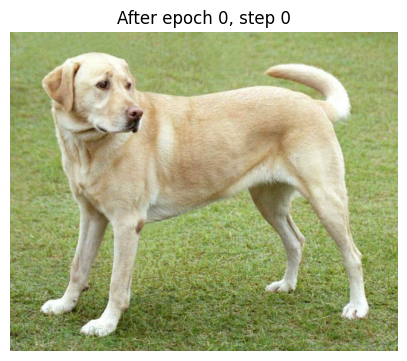

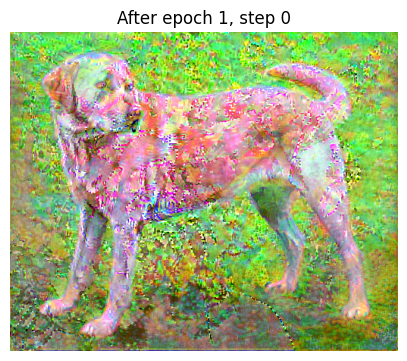

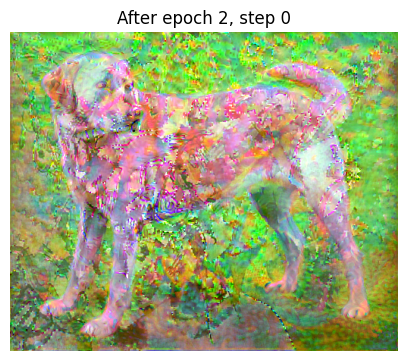

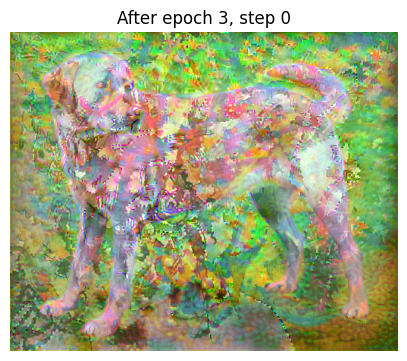

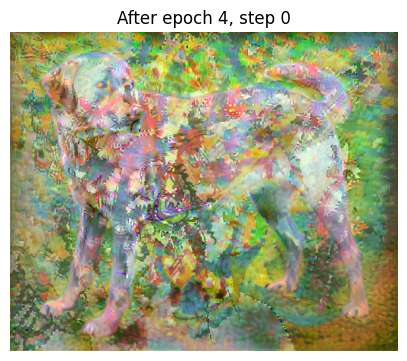

...

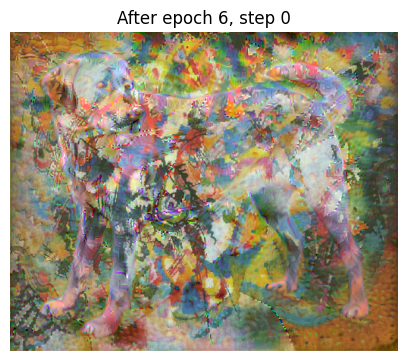

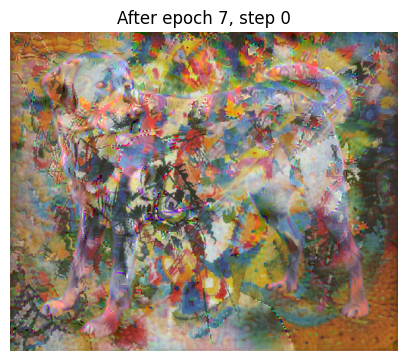

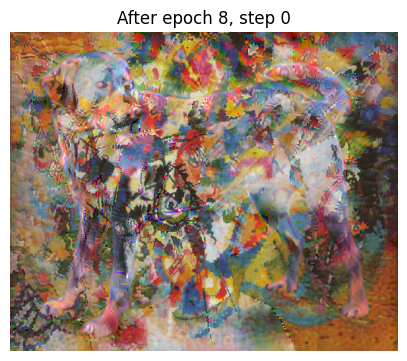

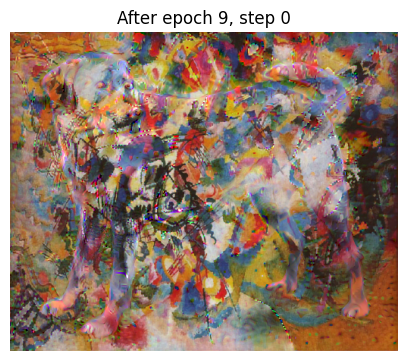

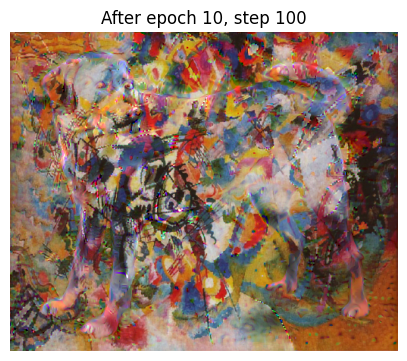

Runtime: 400.02 sec



In [259]:
starting_image = tf.Variable(yellowlab, dtype=tf.float32)
trainer = SWD_Trainer(model, content_loss_MSE, SWD_style_loss, alpha, beta, gamma)

start = time.time()
optimization_loop_SWD(
    'lab and composition',
    starting_image,
    yellowlab_features_flattened,
    composition7_features_flattened,
    trainer,
    show_progression=True
)
end = time.time()
print(f"Runtime: {end - start:.2f} sec\n")


Output for alpha=10000, beta=0.01, gamma=0.1:



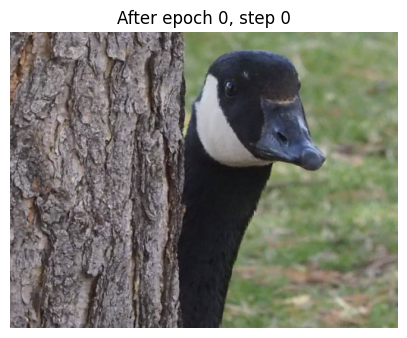

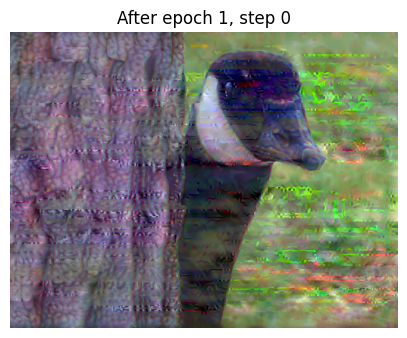

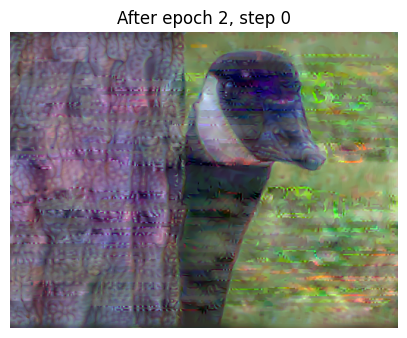

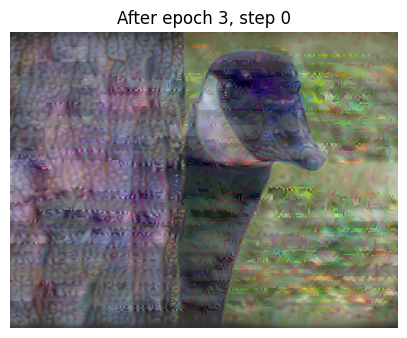

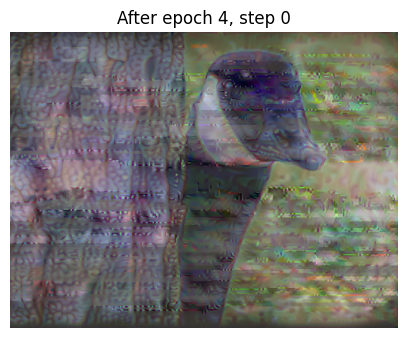

...

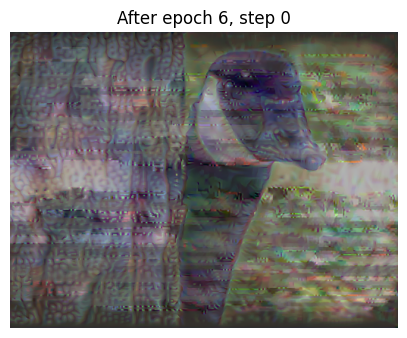

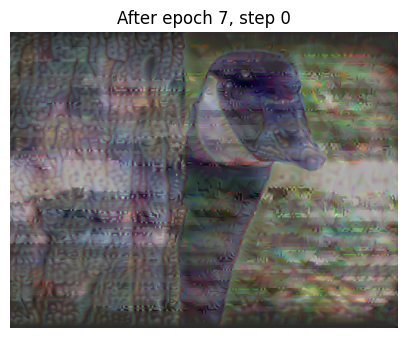

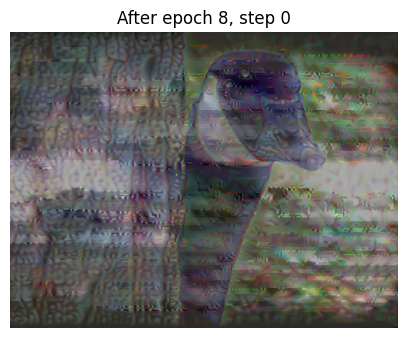

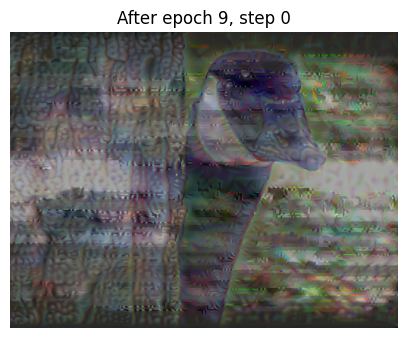

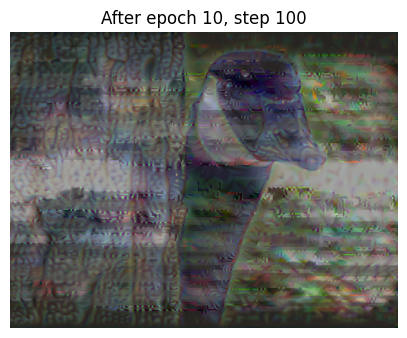

Runtime: 367.14 sec



In [260]:
starting_image = tf.Variable(goose, dtype=tf.float32)
trainer = SWD_Trainer(model, content_loss_MSE, SWD_style_loss, alpha, beta=0.01, gamma=0.1)

start = time.time()
optimization_loop_SWD(
    'goose and glitch',
    starting_image,
    goose_features_flattened,
    glitch_features_flattened,
    trainer,
    show_progression=True
)
end = time.time()
print(f"Runtime: {end - start:.2f} sec\n")


Output for alpha=10000, beta=0.05, gamma=0.1:



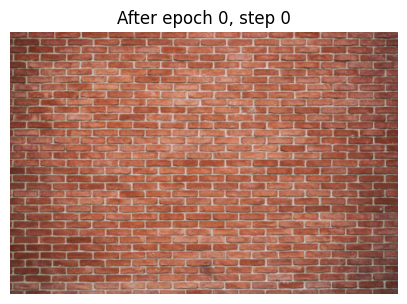

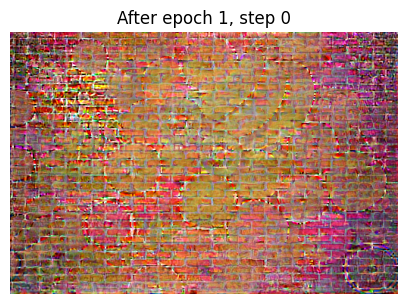

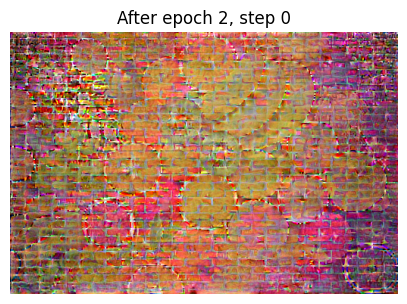

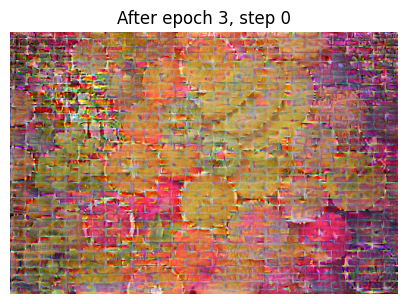

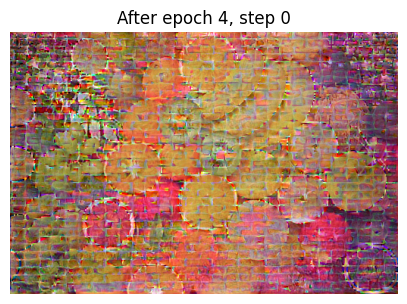

...

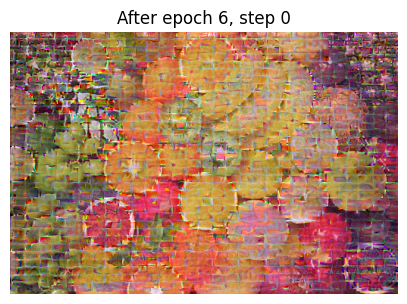

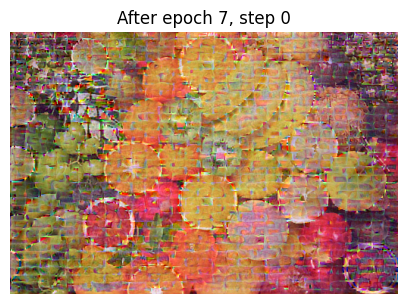

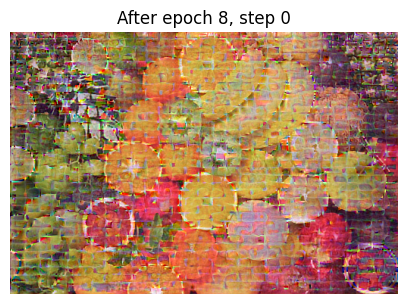

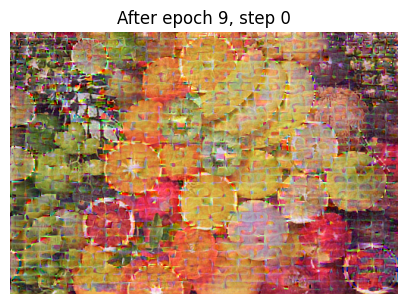

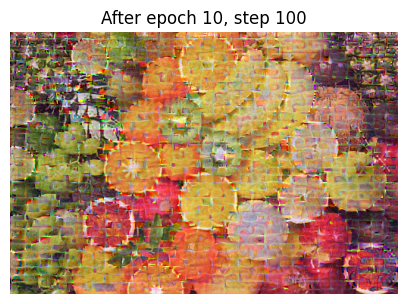

Runtime: 356.07 sec



In [250]:
starting_image = tf.Variable(brickwall, dtype=tf.float32)
trainer = SWD_Trainer(model, content_loss_MSE, SWD_style_loss, alpha, beta, gamma)

start = time.time()
optimization_loop_SWD(
    'wall and fruit',
    starting_image,
    brickwall_features_flattened,
    fruit_features_flattened,
    trainer,
    show_progression=True
)
end = time.time()
print(f"Runtime: {end - start:.2f} sec\n")


Output for alpha=100000, beta=0.05, gamma=0.1:



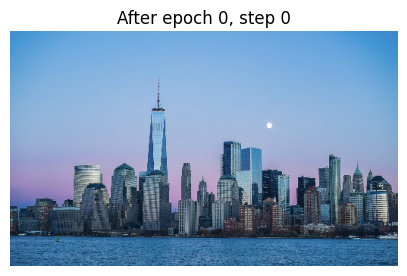

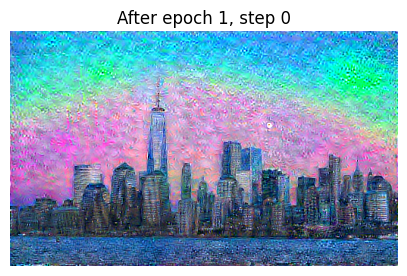

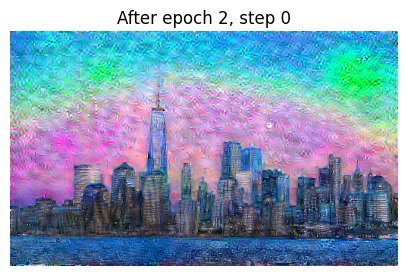

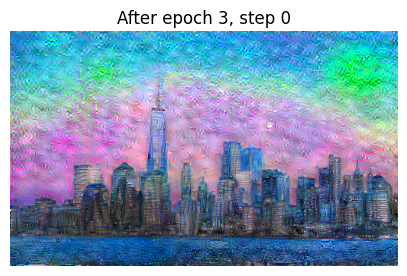

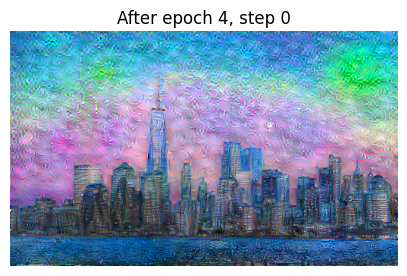

...

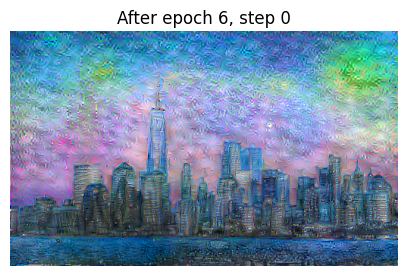

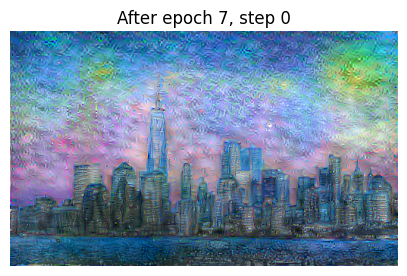

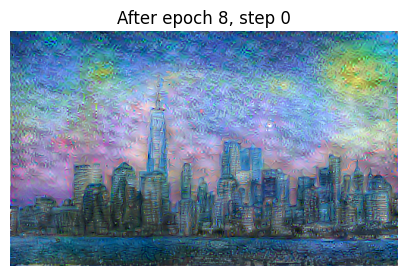

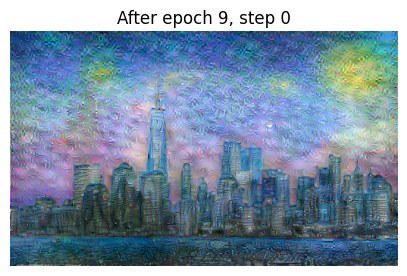

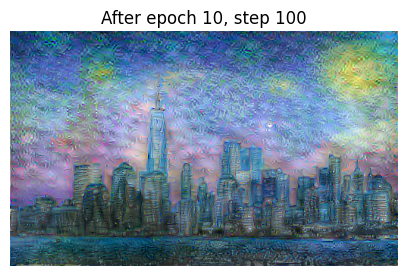

Runtime: 292.46 sec



In [255]:
starting_image = tf.Variable(cityscape, dtype=tf.float32)
trainer = SWD_Trainer(model, content_loss_MSE, SWD_style_loss, alpha=100000, beta=0.05, gamma=0.1)

start = time.time()
optimization_loop_SWD(
    'city scape and starry night',
    starting_image,
    cityscape_features_flattened,
    starrynight_features_flattened,
    trainer,
    show_progression=True
)
end = time.time()
print(f"Runtime: {end - start:.2f} sec\n")

### Experiment with different style extraction layers

In the above examples, the process of image texturing essentially paints the style image onto the content image.

We can also control which style features make up the overall style representation transferred to the content image, depending on which convolutional layers are used for feature extraction.

Trying this with SWD, to see if using fewer style layers can create a representation that isn't as identitcal to the original style image.


In [19]:
content_layers = ['block5_conv2']
style_layers = ['block1_conv1', 'block2_conv1']

model = vgg_style_transfer(vgg, content_layers + style_layers)

yellowlab_features, composition7_features = get_features(model, yellowlab, composition7)

yellowlab_features_flattened = flatten(normalize(yellowlab_features))
composition7_features_flattened = flatten(normalize(composition7_features))


Output for alpha=10000, beta=0.05, gamma=0.1:



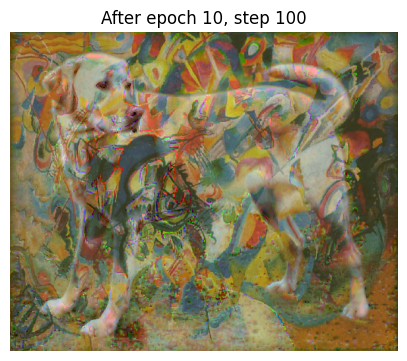

Runtime: 267.48 sec



In [24]:
starting_image = tf.Variable(yellowlab, dtype=tf.float32)

trainer = SWD_Trainer(model, content_loss_MSE, SWD_style_loss, alpha=10000, beta=0.05, gamma=0.1)

start = time.time()
optimization_loop_SWD(
    'lab and composition (reduced layers)',
    starting_image,
    yellowlab_features_flattened,
    composition7_features_flattened,
    trainer,
    show_progression=False 
)
end = time.time()
print(f"Runtime: {end - start:.2f} sec\n")

Here, using fewer style layers gave a more subtle texturing effect, preserving more of the structure and characteristics the original subject.


## Side-by-side results

A quick visual summary of results from implementing the GM and SWD methods from scratch! Both methods successfully transfer style, but with different characteristics:

- **Gram Matrix:** Merges all of the feature maps into a correlation matrix, to define which _aspects_ of style are seen. The content images are reconstructed using the "building blocks" of our target style.
- **SWD:** Matches the output image to the overall feature _distribution_ in the original style image. When features are extracted from many convolutional layers, this essentially creates a texture that is a near identical reconstruction of the style image. Fewer convolutional style layers can be used to create more subtle textures.


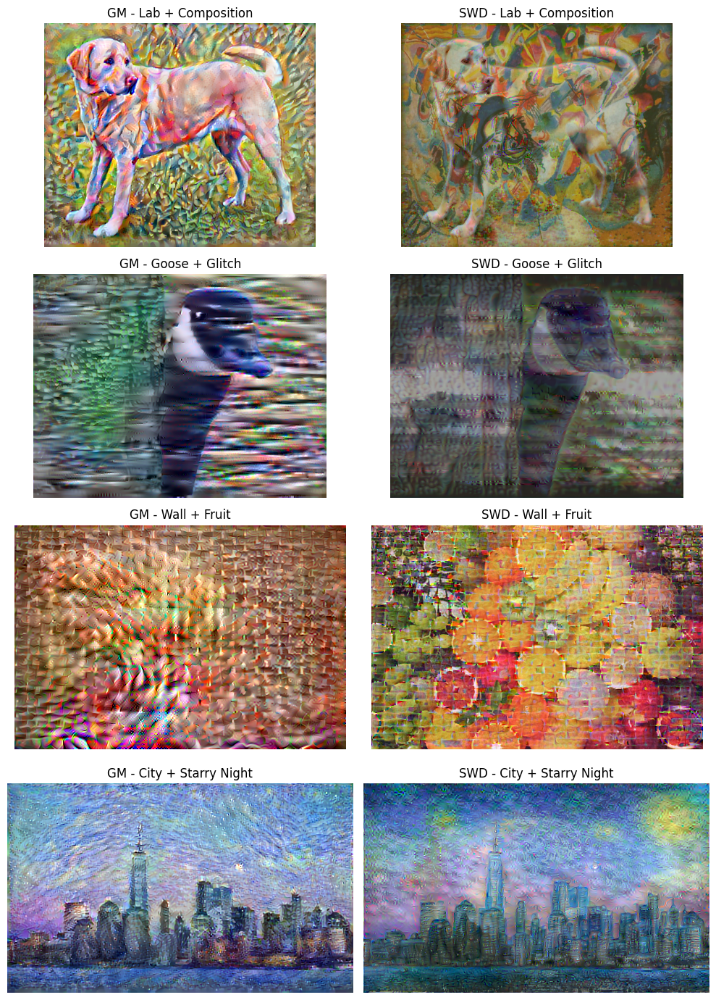

In [27]:
yellowlab_GM = mpimg.imread('results/GM/lab and composition/alpha 1000 beta 10 gamma 0.01/epoch_10_step_100.png')
yellowlab_SWD = mpimg.imread('results/SWD/lab and composition (reduced layers)/alpha 10000 beta 0.05 gamma 0.1/epoch_10_step_100.png')

goose_GM = mpimg.imread('results/GM/goose and glitch/alpha 1000 beta 10 gamma 0.01/epoch_10_step_100.png')
goose_SWD = mpimg.imread('results/SWD/goose and glitch/alpha 10000 beta 0.01 gamma 0.1/epoch_10_step_100.png')

wall_GM = mpimg.imread('results/GM/wall and fruit/alpha 10000 beta 1.0 gamma 0.01/epoch_10_step_100.png')
wall_SWD = mpimg.imread('results/SWD/wall and fruit/alpha 10000 beta 0.05 gamma 0.1/epoch_10_step_100.png')

cityscape_GM = mpimg.imread('results/GM/cityscape and starry night/alpha 1000 beta 10 gamma 0.01/epoch_10_step_100.png')
cityscape_SWD = mpimg.imread('results/SWD/city scape and starry night/alpha 100000 beta 0.05 gamma 0.1/epoch_10_step_100.png')


fig, axes = plt.subplots(nrows=4, ncols=2, figsize=(10, 14))

axes[0, 0].imshow(yellowlab_GM)
axes[0, 0].set_title('GM - Lab + Composition')
axes[0, 0].axis('off')

axes[0, 1].imshow(yellowlab_SWD)
axes[0, 1].set_title('SWD - Lab + Composition')
axes[0, 1].axis('off')

axes[1, 0].imshow(goose_GM)
axes[1, 0].set_title('GM - Goose + Glitch')
axes[1, 0].axis('off')

axes[1, 1].imshow(goose_SWD)
axes[1, 1].set_title('SWD - Goose + Glitch')
axes[1, 1].axis('off')

axes[2, 0].imshow(wall_GM)
axes[2, 0].set_title('GM - Wall + Fruit')
axes[2, 0].axis('off')

axes[2, 1].imshow(wall_SWD)
axes[2, 1].set_title('SWD - Wall + Fruit')
axes[2, 1].axis('off')

axes[3, 0].imshow(cityscape_GM)
axes[3, 0].set_title('GM - City + Starry Night')
axes[3, 0].axis('off')

axes[3, 1].imshow(cityscape_SWD)
axes[3, 1].set_title('SWD - City + Starry Night')
axes[3, 1].axis('off')

plt.tight_layout()
plt.show()